In [1]:
import os
os.environ["CUDA_VISIBLE_DEVICES"]="1"

In [2]:
import numpy as np
import torch
import scanpy as sc
import muon as mu
import anndata
import mudata
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
print(anndata.__version__)
print(mudata.__version__)
print(sc.__version__)
print(torch.__version__)

0.8.0
0.2.1
1.9.2
1.11.0


In [3]:
sc.set_figure_params(scanpy=True, fontsize=14, figsize=[5, 5])

In [3]:
%load_ext autoreload
%autoreload 2

In [5]:
from src.types import TrainParams
from src.model import ModelParams
from src.smvae.model import SMVAE
from src.smvae.train import train_smvae
from src.smvae.dataloader import *
from src.smvae.diagnostics import plot_embedding, classification_performance

In [4]:
# mdata = mu.read('/media/yob/nacho_stuff/prostate_cancer/Integration/MVAE-PoE/OtF-prostate/data/mdata_preprocessed_final_filtered.h5mu')
# metadata = mu.read('/media/yob/nacho_stuff/prostate_cancer/Integration/MVAE-PoE/OtF-prostate/data/mdata_metadata.h5mu')
# mdata.obs["new_ann"] = metadata.obs["new_ann"]
# mdata.mod["msi"].obs["new_ann"] = metadata.obs["new_ann"]
# mdata.mod["rna"].obs["new_ann"] = metadata.obs["new_ann"]
# mdata
mdata = mu.read('/media/gambino/students_workdir/anna/OtF-prostate/data/mdata_out_smvae.h5mu')

## Give human readable labels

In [50]:
mdata.obs["tissue_name"] = mdata.obs["tissue"].apply(lambda x: "Cancer" if x == "DLC2" else "Normal")

mdata.obs["cell_type"] = mdata.obs["new_ann"]

In [41]:
def sample_transl(x):
    patient = x.split("_")[0]
    status = x.split("_")[1]
    if status == "DLC2":
        return f"{patient}_cancer"
    return f"{patient}_\nnormal"
mdata.obs["sample_name"] = mdata.obs["sample"].apply(lambda x: sample_transl(x))


## Heatmap of annotation frequencies across samples

In [51]:
a = pd.DataFrame(mdata.obs.groupby(["cell_type", "sample_name"])["cell_type"].count())
a['percent'] = a.groupby(level=0).transform(lambda x: (x / x.sum()).round(2))
a = a.drop(columns=["cell_type"]).reset_index()
a

,cell_type,sample_name,percent
0,Atrophy,PWB929\nnormal,0.17
1,Atrophy,PWB929\ncancer,0.00
2,Atrophy,PWB931\nnormal,0.00
3,Atrophy,PWB931\ncancer,0.00
4,Atrophy,PWB934\nnormal,0.00
...,...,...,...
219,Unlabelled,PWB947\ncancer,0.05
220,Unlabelled,PWB950\nnormal,0.02
221,Unlabelled,PWB950\ncancer,0.03
222,Unlabelled,PWB952\nnormal,0.03


/tmp/ipykernel_3318555/491012491.py:4: FutureWarning: In a future version of pandas all arguments of DataFrame.pivot will be keyword-only.
  sns.heatmap(a.pivot("sample_name", "cell_type"), ax=ax, xticklabels=a["cell_type"].unique(), cbar_kws={"label": "% of spots with annotation"})


[Text(0.5, 74.7222222222222, 'Annotation'),
 Text(66.5222222222222, 0.5, 'Sample')]

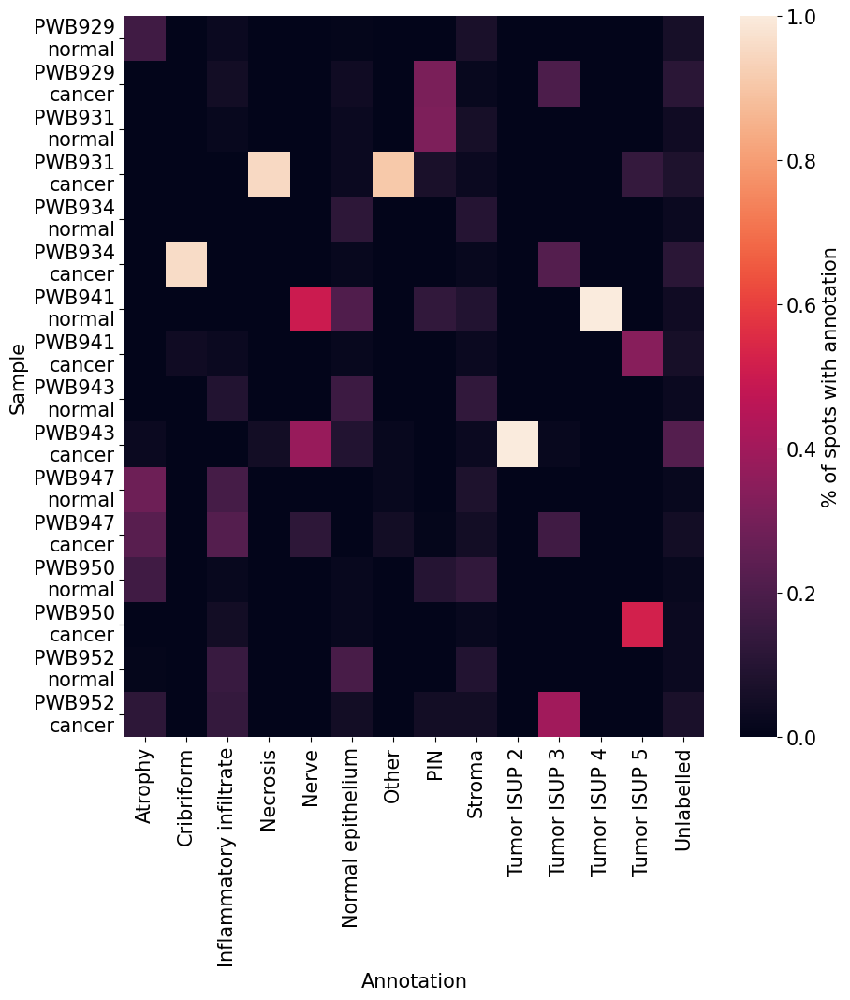

In [61]:
plt.rcParams.update({'font.size': 15})

fig, ax = plt.subplots(figsize=(10,10)) 
sns.heatmap(a.pivot("sample_name", "cell_type"), ax=ax, xticklabels=a["cell_type"].unique(), cbar_kws={"label": "% of spots with annotation"})
ax.set(xlabel="Annotation", ylabel="Sample")
# for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] +
#              ax.get_xticklabels() + ax.get_yticklabels()):
#     item.set_fontsize(15)

### Save output of all SMVAE models

In [ ]:
models = {
    "smvae_beta0.5": "smvae_prostate_nolisi_beta0.5_20230513-172539.pt",
    "smvae_beta0.1": "smvae_prostate_nolisi_beta0.1_20230513-002431.pt",
    "smvae_beta0.01": "smvae_prostate_nolisi_fullshared_20230429-174252.pt",
    "smvae_beta0.001": "smvae_prostate_nolisi_beta0.001_20230512-195310.pt",
#     "smvae_beta0.1_gamma0.0001": "smvae_prostate_lisi_poe_beta0.1_gamma0.0001_20230513-014606.pt",
    "smvae_beta0.001_gamma0.0001": "smvae_prostate_lisi_poe_beta0.001_gamma0.0001_20230502-031102.pt",
    "smvae_beta0.001_gamma0.0003": "smvae_prostate_lisi_poe_beta0.001_gamma0.0003_20230503-151506.pt",
    "smvae_beta0.001_gamma0.0005": "smvae_prostate_lisi_poe_beta0.001_gamma0.0005_20230502-133449.pt",
    "smvae_beta0.001_gamma0.001": "smvae_prostate_lisi_poe_beta0.001_gamma0.001_20230502-001455.pt",
#     "smvae_beta0.001_gamma0.01": "smvae_prostate_lisi_poe_beta0.001_20230430-012112.pt",
    "smvae_beta0.001_gamma0.0005_delta0.1": "smvae_prostate_lisi_private_beta0.001_gamma0.0005_delta0.1_20230503-015025.pt",
    "smvae_beta0.001_gamma0.0005_delta1.0": "smvae_prostate_lisi_private_beta0.001_gamma0.0005_delta1.0_20230515-204305.pt"
}

model_names = {
    "smvae_beta0.5": r"SMVAE($\beta=0.5$)",
    "smvae_beta0.1": r"SMVAE($\beta=0.1$)",
    "smvae_beta0.01": r"SMVAE($\beta=0.01$)",
    "smvae_beta0.001": r"SMVAE($\beta=0.001$)",
    "smvae_beta0.001_gamma0.0001": r"SMVAE($\beta=0.001, \gamma=0.0001$)",
    "smvae_beta0.001_gamma0.0003": r"SMVAE($\beta=0.001, \gamma=0.0003$)",
    "smvae_beta0.001_gamma0.0005": r"SMVAE($\beta=0.001, \gamma=0.0005$)",
    "smvae_beta0.001_gamma0.001": r"SMVAE($\beta=0.001, \gamma=0.001$)",
    "smvae_beta0.001_gamma0.0005_delta0.1": r"SMVAE($\beta=0.001, \gamma=0.0005, \delta=0.1$)",
    "smvae_beta0.001_gamma0.0005_delta1.0": r"SMVAE($\beta=0.001, \gamma=0.0005, \delta=1.0$)",
}

train_params = TrainParams(train_size=0.8, n_epochs=100, learning_rate=1e-4, batch_size=128)
model_params = ModelParams(beta=0.001, n_layers=2, z_dim=100, n_hidden=300, use_cuda=True)

In [9]:
# torch.set_num_threads(16)

# for m, file in {"smvae_beta0.001_gamma0.0005_delta1.0": "smvae_prostate_lisi_private_beta0.001_gamma0.0005_delta1.0_20230515-204305.pt"}.items():
#     print(m)
#     model = SMVAE(mdata, model_params)
#     model.load_state_dict(torch.load(f"vae_params/{file}"))
#     from src.smvae.train import to_latent
#     poe, rna_p, msi_p, rna_s, msi_s = to_latent(model, mdata, "sample", train_params)
#     mdata.obsm[f"{m}_z1_s"] = np.vstack(rna_s)
#     mdata.obsm[f"{m}_z2_s"] = np.vstack(msi_s)
#     mdata.obsm[f"{m}_z1_p"] = np.vstack(rna_p)
#     mdata.obsm[f"{m}_z2_p"] = np.vstack(msi_p)
#     mdata.obsm[f"{m}_z"] = np.vstack([x.numpy() for x in poe])
    
#     for layer in ["z1_s", "z2_s", "z1_p", "z2_p"]:
#         sc.pp.neighbors(
#             mdata, n_neighbors=5, use_rep=f"{m}_{layer}", key_added=f"{m}_neigh_{layer}"
#         )
#         sc.tl.umap(mdata, neighbors_key=f"{m}_neigh_{layer}")
#         mdata.obsm[f"X_{m}_{layer}"] = mdata.obsm["X_umap"]
    
#     sc.pp.neighbors(mdata, use_rep=f"{m}_z", n_neighbors=30)
#     sc.tl.umap(mdata)
#     mdata.obsm[f"X_{m}_z"] = mdata.obsm["X_umap"]
    
#     mdata.obsp = {}
#     for layer in ["z1_s","z2_s","z1_p","z2_p","z"]:
#         mdata.obsm.pop(f"{m}_{layer}")
# mdata.write('/media/gambino/students_workdir/anna/OtF-prostate/data/mdata_out_smvae.h5mu')

smvae_beta0.001_gamma0.0005_delta1.0
(42475, 18950)
(42475, 12510)


100%|█████████████████████████████████████████| 332/332 [00:35<00:00,  9.41it/s]


## Shared change with beta

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/

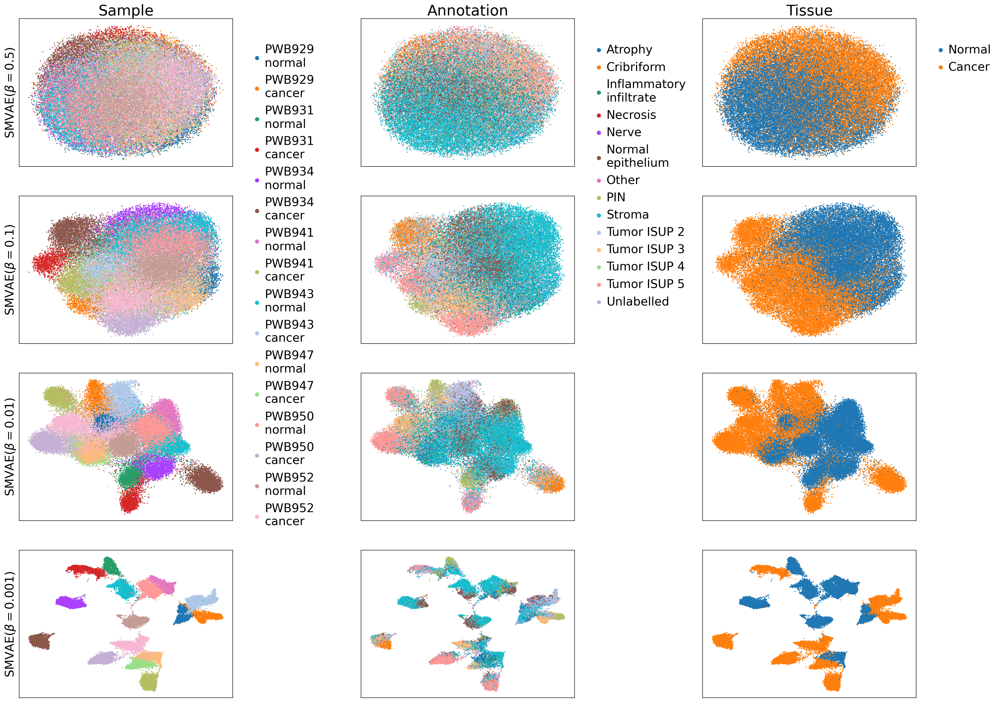

In [33]:
row_num = 4
col_num = 3
fig, axes = plt.subplots(row_num, col_num, figsize=[27, 21])
fig.subplots_adjust(wspace=0.6)
for i, m in enumerate(["smvae_beta0.5", "smvae_beta0.1", "smvae_beta0.01", "smvae_beta0.001"]):
    if i != 0:
        sc.pl.embedding(mdata, f"X_{m}_z", ax=axes[i][0], color="sample_name", show=False, title="", size=15, legend_loc=None)
        sc.pl.embedding(mdata, f"X_{m}_z", ax=axes[i][1], color="cell_type", show=False, title="", size=15, legend_loc=None)
        sc.pl.embedding(mdata,  f"X_{m}_z",ax=axes[i][2], color="tissue_name", show=False, title="", size=15, legend_loc=None)
    else:
        sc.pl.embedding(mdata, f"X_{m}_z", ax=axes[i][0], color="sample_name", show=False, title="Sample", size=15)
        sc.pl.embedding(mdata, f"X_{m}_z", ax=axes[i][1], color="cell_type", show=False, title="Annotation", size=15)
        sc.pl.embedding(mdata,  f"X_{m}_z",ax=axes[i][2], color="tissue_name", show=False, title="Tissue", size=15)
        axes[i][0].legend(ncol=1, fontsize=20, bbox_to_anchor=(1.05, 0.9), frameon=False, alignment='center')
        axes[i][1].legend(ncol=1, fontsize=20, bbox_to_anchor=(1.05, 0.9), frameon=False, alignment='center')
        axes[i][2].legend(ncol=1, fontsize=20, bbox_to_anchor=(1.05, 0.9), frameon=False, alignment='center')
            
    for j in range(col_num):
        axes[i][j].title.set_size(25)
        if j == 0:
            axes[i][j].set_ylabel(model_names[m], fontsize=20)
        else:
            axes[i][j].set_ylabel("", fontsize=20)
        axes[i][j].set_xlabel("")
            
plt.savefig("figures/shared_smvae_beta.png", bbox_inches="tight", pad_inches=0.5)

In [ ]:
row_num = 4
col_num = 3
fig, axes = plt.subplots(row_num, col_num, figsize=[27, 21])
fig.subplots_adjust(wspace=0.6)
for i, m in enumerate(["smvae_beta0.5", "smvae_beta0.1", "smvae_beta0.01", "smvae_beta0.001"]):
    if i != 0:
        sc.pl.embedding(mdata, f"X_{m}_z2_s", ax=axes[i][0], color="sample_name", show=False, title="", size=15, legend_loc=None)
        sc.pl.embedding(mdata, f"X_{m}_z2_s", ax=axes[i][1], color="cell_type", show=False, title="", size=15, legend_loc=None)
        sc.pl.embedding(mdata,  f"X_{m}_z2_s",ax=axes[i][2], color="tissue_name", show=False, title="", size=15, legend_loc=None)
    else:
        sc.pl.embedding(mdata, f"X_{m}_z2_s", ax=axes[i][0], color="sample_name", show=False, title="Sample", size=15)
        sc.pl.embedding(mdata, f"X_{m}_z2_s", ax=axes[i][1], color="cell_type", show=False, title="Annotation", size=15)
        sc.pl.embedding(mdata,  f"X_{m}_z2_s",ax=axes[i][2], color="tissue_name", show=False, title="Tissue", size=15)
        axes[i][0].legend(ncol=1, fontsize=20, bbox_to_anchor=(1.05, 0.9), frameon=False, alignment='center')
        axes[i][1].legend(ncol=1, fontsize=20, bbox_to_anchor=(1.05, 0.9), frameon=False, alignment='center')
        axes[i][2].legend(ncol=1, fontsize=20, bbox_to_anchor=(1.05, 0.9), frameon=False, alignment='center')
            
    for j in range(col_num):
        axes[i][j].title.set_size(25)
        if j == 0:
            axes[i][j].set_ylabel(model_names[m], fontsize=20)
        else:
            axes[i][j].set_ylabel("", fontsize=20)
        axes[i][j].set_xlabel("")
            
plt.savefig("figures/shared_msi_smvae_beta.png", bbox_inches="tight", pad_inches=0.5)

In [ ]:
row_num = 4
col_num = 3
fig, axes = plt.subplots(row_num, col_num, figsize=[27, 21])
fig.subplots_adjust(wspace=0.6)
for i, m in enumerate(["smvae_beta0.5", "smvae_beta0.1", "smvae_beta0.01", "smvae_beta0.001"]):
    if i != 0:
        sc.pl.embedding(mdata, f"X_{m}_z1_s", ax=axes[i][0], color="sample_name", show=False, title="", size=15, legend_loc=None)
        sc.pl.embedding(mdata, f"X_{m}_z1_s", ax=axes[i][1], color="cell_type", show=False, title="", size=15, legend_loc=None)
        sc.pl.embedding(mdata,  f"X_{m}_z1_s",ax=axes[i][2], color="tissue_name", show=False, title="", size=15, legend_loc=None)
    else:
        sc.pl.embedding(mdata, f"X_{m}_z1_s", ax=axes[i][0], color="sample_name", show=False, title="Sample", size=15)
        sc.pl.embedding(mdata, f"X_{m}_z1_s", ax=axes[i][1], color="cell_type", show=False, title="Annotation", size=15)
        sc.pl.embedding(mdata,  f"X_{m}_z1_s",ax=axes[i][2], color="tissue_name", show=False, title="Tissue", size=15)
        axes[i][0].legend(ncol=1, fontsize=20, bbox_to_anchor=(1.05, 0.9), frameon=False, alignment='center')
        axes[i][1].legend(ncol=1, fontsize=20, bbox_to_anchor=(1.05, 0.9), frameon=False, alignment='center')
        axes[i][2].legend(ncol=1, fontsize=20, bbox_to_anchor=(1.05, 0.9), frameon=False, alignment='center')
            
    for j in range(col_num):
        axes[i][j].title.set_size(25)
        if j == 0:
            axes[i][j].set_ylabel(model_names[m], fontsize=20)
        else:
            axes[i][j].set_ylabel("", fontsize=20)
        axes[i][j].set_xlabel("")
            
plt.savefig("figures/shared_rna_smvae_beta.png", bbox_inches="tight", pad_inches=0.5)

### Private change with beta

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/

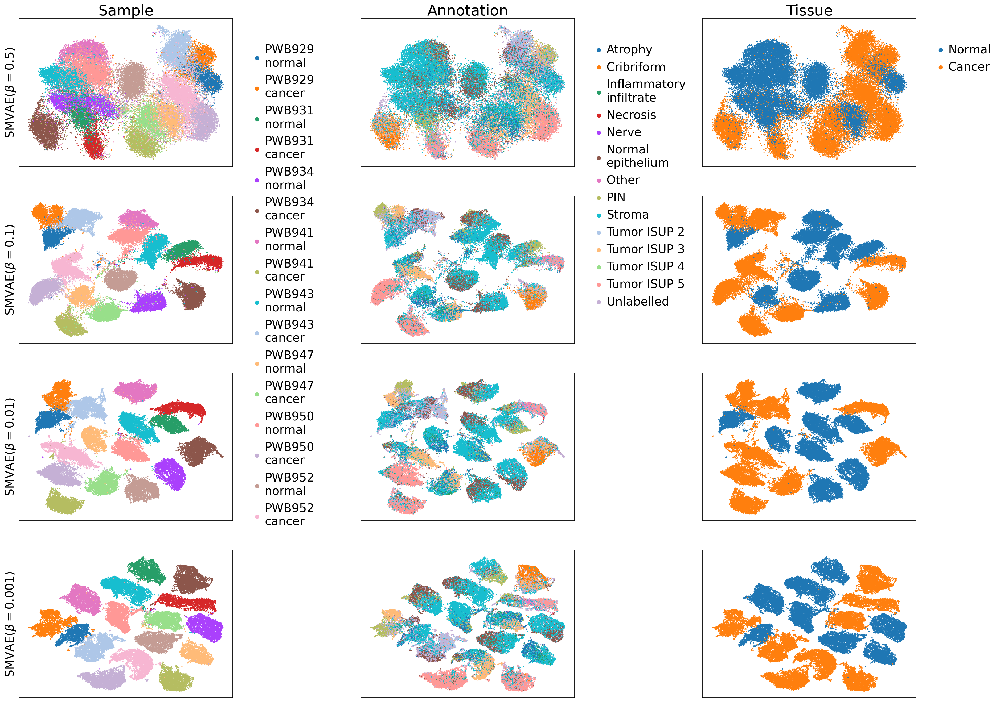

In [53]:
row_num = 4
col_num = 3
fig, axes = plt.subplots(row_num, col_num, figsize=[27, 21])
fig.subplots_adjust(wspace=0.6)
for i, m in enumerate(["smvae_beta0.5", "smvae_beta0.1", "smvae_beta0.01", "smvae_beta0.001"]):
    if i != 0:
        sc.pl.embedding(mdata, f"X_{m}_z2_p", ax=axes[i][0], color="sample_name", show=False, title="", size=15, legend_loc=None)
        sc.pl.embedding(mdata, f"X_{m}_z2_p", ax=axes[i][1], color="cell_type", show=False, title="", size=15, legend_loc=None)
        sc.pl.embedding(mdata,  f"X_{m}_z2_p",ax=axes[i][2], color="tissue_name", show=False, title="", size=15, legend_loc=None)
    else:
        sc.pl.embedding(mdata, f"X_{m}_z2_p", ax=axes[i][0], color="sample_name", show=False, title="Sample", size=15)
        sc.pl.embedding(mdata, f"X_{m}_z2_p", ax=axes[i][1], color="cell_type", show=False, title="Annotation", size=15)
        sc.pl.embedding(mdata,  f"X_{m}_z2_p",ax=axes[i][2], color="tissue_name", show=False, title="Tissue", size=15)
        axes[i][0].legend(ncol=1, fontsize=20, bbox_to_anchor=(1.05, 0.9), frameon=False, alignment='center')
        axes[i][1].legend(ncol=1, fontsize=20, bbox_to_anchor=(1.05, 0.9), frameon=False, alignment='center')
        axes[i][2].legend(ncol=1, fontsize=20, bbox_to_anchor=(1.05, 0.9), frameon=False, alignment='center')
            
    for j in range(col_num):
        axes[i][j].title.set_size(25)
        if j == 0:
            axes[i][j].set_ylabel(model_names[m], fontsize=20)
        else:
            axes[i][j].set_ylabel("", fontsize=20)
        axes[i][j].set_xlabel("")
            
plt.savefig("figures/private_msi_smvae_beta.png", bbox_inches="tight", pad_inches=0.5)

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/

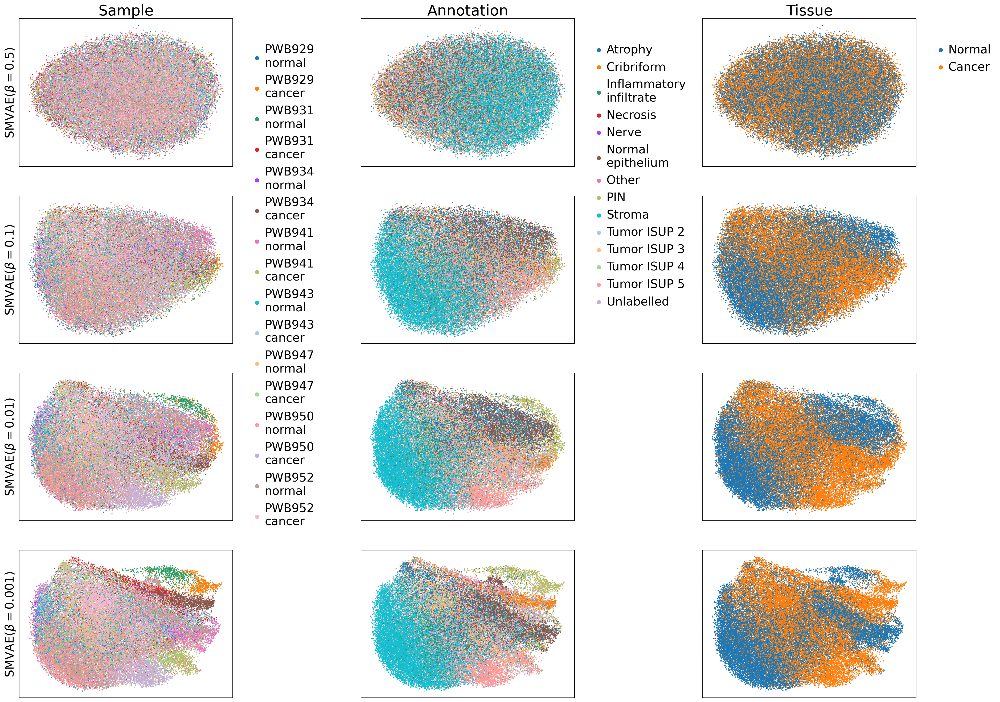

In [48]:
row_num = 4
col_num = 3
fig, axes = plt.subplots(row_num, col_num, figsize=[27, 21])
fig.subplots_adjust(wspace=0.6)
for i, m in enumerate(["smvae_beta0.5", "smvae_beta0.1", "smvae_beta0.01", "smvae_beta0.001"]):
    if i != 0:
        sc.pl.embedding(mdata, f"X_{m}_z1_p", ax=axes[i][0], color="sample_name", show=False, title="", size=15, legend_loc=None)
        sc.pl.embedding(mdata, f"X_{m}_z1_p", ax=axes[i][1], color="cell_type", show=False, title="", size=15, legend_loc=None)
        sc.pl.embedding(mdata,  f"X_{m}_z1_p",ax=axes[i][2], color="tissue_name", show=False, title="", size=15, legend_loc=None)
    else:
        sc.pl.embedding(mdata, f"X_{m}_z1_p", ax=axes[i][0], color="sample_name", show=False, title="Sample", size=15)
        sc.pl.embedding(mdata, f"X_{m}_z1_p", ax=axes[i][1], color="cell_type", show=False, title="Annotation", size=15)
        sc.pl.embedding(mdata,  f"X_{m}_z1_p",ax=axes[i][2], color="tissue_name", show=False, title="Tissue", size=15)
        axes[i][0].legend(ncol=1, fontsize=20, bbox_to_anchor=(1.05, 0.9), frameon=False, alignment='center')
        axes[i][1].legend(ncol=1, fontsize=20, bbox_to_anchor=(1.05, 0.9), frameon=False, alignment='center')
        axes[i][2].legend(ncol=1, fontsize=20, bbox_to_anchor=(1.05, 0.9), frameon=False, alignment='center')
    for j in range(col_num):
        axes[i][j].title.set_size(25)
        if j == 0:
            axes[i][j].set_ylabel(model_names[m], fontsize=20)
        else:
            axes[i][j].set_ylabel("", fontsize=20)
        axes[i][j].set_xlabel("")
            
plt.savefig("figures/private_rna_smvae_beta.png", bbox_inches="tight", pad_inches=0.5)

### Shared change with gamma

In [ ]:
row_num = 4
col_num = 3
fig, axes = plt.subplots(row_num, col_num, figsize=[27, 21])
fig.subplots_adjust(wspace=0.6)
for i, m in enumerate(["smvae_beta0.001", "smvae_beta0.001_gamma0.0001", "smvae_beta0.001_gamma0.0003","smvae_beta0.001_gamma0.0005"]):
    if i != 0:
        sc.pl.embedding(mdata, f"X_{m}_z", ax=axes[i][0], color="sample_name", show=False, title="", size=15, legend_loc=None)
        sc.pl.embedding(mdata, f"X_{m}_z", ax=axes[i][1], color="cell_type", show=False, title="", size=15, legend_loc=None)
        sc.pl.embedding(mdata,  f"X_{m}_z",ax=axes[i][2], color="tissue_name", show=False, title="", size=15, legend_loc=None)
    else:
        sc.pl.embedding(mdata, f"X_{m}_z", ax=axes[i][0], color="sample_name", show=False, title="Sample", size=15)
        sc.pl.embedding(mdata, f"X_{m}_z", ax=axes[i][1], color="cell_type", show=False, title="Annotation", size=15)
        sc.pl.embedding(mdata,  f"X_{m}_z",ax=axes[i][2], color="tissue_name", show=False, title="Tissue", size=15)
        axes[i][0].legend(ncol=1, fontsize=20, bbox_to_anchor=(1.05, 0.9), frameon=False, alignment='center')
        axes[i][1].legend(ncol=1, fontsize=20, bbox_to_anchor=(1.05, 0.9), frameon=False, alignment='center')
        axes[i][2].legend(ncol=1, fontsize=20, bbox_to_anchor=(1.05, 0.9), frameon=False, alignment='center')
    for j in range(col_num):
        axes[i][j].title.set_size(25)
        if j == 0:
            axes[i][j].set_ylabel(model_names[m], fontsize=15)
        else:
            axes[i][j].set_ylabel("", fontsize=20)
        axes[i][j].set_xlabel("")
            
plt.savefig("figures/shared_smvae_gamma.png", bbox_inches="tight", pad_inches=0.5)

In [ ]:
row_num = 4
col_num = 3
fig, axes = plt.subplots(row_num, col_num, figsize=[27, 21])
fig.subplots_adjust(wspace=0.6)
for i, m in enumerate(["smvae_beta0.001", "smvae_beta0.001_gamma0.0001", "smvae_beta0.001_gamma0.0003","smvae_beta0.001_gamma0.0005"]):
    if i != 0:
        sc.pl.embedding(mdata, f"X_{m}_z1_s", ax=axes[i][0], color="sample_name", show=False, title="", size=15, legend_loc=None)
        sc.pl.embedding(mdata, f"X_{m}_z1_s", ax=axes[i][1], color="cell_type", show=False, title="", size=15, legend_loc=None)
        sc.pl.embedding(mdata,  f"X_{m}_z1_s",ax=axes[i][2], color="tissue_name", show=False, title="", size=15, legend_loc=None)
    else:
        sc.pl.embedding(mdata, f"X_{m}_z1_s", ax=axes[i][0], color="sample_name", show=False, title="Sample", size=15)
        sc.pl.embedding(mdata, f"X_{m}_z1_s", ax=axes[i][1], color="cell_type", show=False, title="Annotation", size=15)
        sc.pl.embedding(mdata,  f"X_{m}_z1_s",ax=axes[i][2], color="tissue_name", show=False, title="Tissue", size=15)
        axes[i][0].legend(ncol=1, fontsize=20, bbox_to_anchor=(1.05, 0.9), frameon=False, alignment='center')
        axes[i][1].legend(ncol=1, fontsize=20, bbox_to_anchor=(1.05, 0.9), frameon=False, alignment='center')
        axes[i][2].legend(ncol=1, fontsize=20, bbox_to_anchor=(1.05, 0.9), frameon=False, alignment='center')
    for j in range(col_num):
        axes[i][j].title.set_size(25)
        if j == 0:
            axes[i][j].set_ylabel(model_names[m], fontsize=15)
        else:
            axes[i][j].set_ylabel("", fontsize=20)
        axes[i][j].set_xlabel("")
            
plt.savefig("figures/shared_rna_smvae_gamma.png", bbox_inches="tight", pad_inches=0.5)

In [ ]:
row_num = 4
col_num = 3
fig, axes = plt.subplots(row_num, col_num, figsize=[27, 21])
fig.subplots_adjust(wspace=0.6)
for i, m in enumerate(["smvae_beta0.001", "smvae_beta0.001_gamma0.0001", "smvae_beta0.001_gamma0.0003","smvae_beta0.001_gamma0.0005"]):
    if i != 0:
        sc.pl.embedding(mdata, f"X_{m}_z2_s", ax=axes[i][0], color="sample_name", show=False, title="", size=15, legend_loc=None)
        sc.pl.embedding(mdata, f"X_{m}_z2_s", ax=axes[i][1], color="cell_type", show=False, title="", size=15, legend_loc=None)
        sc.pl.embedding(mdata,  f"X_{m}_z2_s",ax=axes[i][2], color="tissue_name", show=False, title="", size=15, legend_loc=None)
    else:
        sc.pl.embedding(mdata, f"X_{m}_z2_s", ax=axes[i][0], color="sample_name", show=False, title="Sample", size=15)
        sc.pl.embedding(mdata, f"X_{m}_z2_s", ax=axes[i][1], color="cell_type", show=False, title="Annotation", size=15)
        sc.pl.embedding(mdata,  f"X_{m}_z2_s",ax=axes[i][2], color="tissue_name", show=False, title="Tissue", size=15)
        axes[i][0].legend(ncol=1, fontsize=20, bbox_to_anchor=(1.05, 0.9), frameon=False, alignment='center')
        axes[i][1].legend(ncol=1, fontsize=20, bbox_to_anchor=(1.05, 0.9), frameon=False, alignment='center')
        axes[i][2].legend(ncol=1, fontsize=20, bbox_to_anchor=(1.05, 0.9), frameon=False, alignment='center')
    for j in range(col_num):
        axes[i][j].title.set_size(25)
        if j == 0:
            axes[i][j].set_ylabel(model_names[m], fontsize=15)
        else:
            axes[i][j].set_ylabel("", fontsize=20)
        axes[i][j].set_xlabel("")
            
plt.savefig("figures/shared_msi_smvae_gamma.png", bbox_inches="tight", pad_inches=0.5)

In [ ]:
row_num = 3
col_num = 3
fig, axes = plt.subplots(row_num, col_num, figsize=[27, 21])
fig.subplots_adjust(wspace=0.6)
for i, m in enumerate(["smvae_beta0.001", "smvae_beta0.001_gamma0.0001","smvae_beta0.001_gamma0.0005"]):
    if i != 0:
        sc.pl.embedding(mdata, f"X_{m}_z1_p", ax=axes[i][0], color="sample_name", show=False, title="", size=15, legend_loc=None)
        sc.pl.embedding(mdata, f"X_{m}_z1_p", ax=axes[i][1], color="cell_type", show=False, title="", size=15, legend_loc=None)
        sc.pl.embedding(mdata,  f"X_{m}_z1_p",ax=axes[i][2], color="tissue_name", show=False, title="", size=15, legend_loc=None)
    else:
        sc.pl.embedding(mdata, f"X_{m}_z1_p", ax=axes[i][0], color="sample_name", show=False, title="Sample", size=15)
        sc.pl.embedding(mdata, f"X_{m}_z1_p", ax=axes[i][1], color="cell_type", show=False, title="Annotation", size=15)
        sc.pl.embedding(mdata,  f"X_{m}_z1_p",ax=axes[i][2], color="tissue_name", show=False, title="Tissue", size=15)
        axes[i][0].legend(ncol=1, fontsize=20, bbox_to_anchor=(1.05, 0.9), frameon=False, alignment='center')
        axes[i][1].legend(ncol=1, fontsize=20, bbox_to_anchor=(1.05, 0.9), frameon=False, alignment='center')
        axes[i][2].legend(ncol=1, fontsize=20, bbox_to_anchor=(1.05, 0.9), frameon=False, alignment='center')
    for j in range(col_num):
        axes[i][j].title.set_size(25)
        if j == 0:
            axes[i][j].set_ylabel(model_names[m], fontsize=15)
        else:
            axes[i][j].set_ylabel("", fontsize=20)
        axes[i][j].set_xlabel("")
            
plt.savefig("figures/private_rna_smvae_gamma.png", bbox_inches="tight", pad_inches=0.5)

### shared change with delta

In [ ]:
row_num = 3
col_num = 3
fig, axes = plt.subplots(row_num, col_num, figsize=[27, 21])
fig.subplots_adjust(wspace=0.6)
for i, m in enumerate(["smvae_beta0.001_gamma0.0005", "smvae_beta0.001_gamma0.0005_delta0.1", "smvae_beta0.001_gamma0.0005_delta1.0"]):
    if i != 0:
        sc.pl.embedding(mdata, f"X_{m}_z", ax=axes[i][0], color="sample_name", show=False, title="", size=15, legend_loc=None)
        sc.pl.embedding(mdata, f"X_{m}_z", ax=axes[i][1], color="cell_type", show=False, title="", size=15, legend_loc=None)
        sc.pl.embedding(mdata,  f"X_{m}_z",ax=axes[i][2], color="tissue_name", show=False, title="", size=15, legend_loc=None)
    else:
        sc.pl.embedding(mdata, f"X_{m}_z", ax=axes[i][0], color="sample_name", show=False, title="Sample", size=15)
        sc.pl.embedding(mdata, f"X_{m}_z", ax=axes[i][1], color="cell_type", show=False, title="Annotation", size=15)
        sc.pl.embedding(mdata,  f"X_{m}_z",ax=axes[i][2], color="tissue_name", show=False, title="Tissue", size=15)
        axes[i][0].legend(ncol=1, fontsize=20, bbox_to_anchor=(1.05, 0.9), frameon=False, alignment='center')
        axes[i][1].legend(ncol=1, fontsize=20, bbox_to_anchor=(1.05, 0.9), frameon=False, alignment='center')
        axes[i][2].legend(ncol=1, fontsize=20, bbox_to_anchor=(1.05, 0.9), frameon=False, alignment='center')
    for j in range(col_num):
        axes[i][j].title.set_size(25)
        if j == 0:
            axes[i][j].set_ylabel(model_names[m], fontsize=15)
        else:
            axes[i][j].set_ylabel("", fontsize=20)
        axes[i][j].set_xlabel("")
            
plt.savefig("figures/shared_smvae_delta.png", bbox_inches="tight", pad_inches=0.5)

### private change with delta

In [ ]:
row_num = 3
col_num = 3
fig, axes = plt.subplots(row_num, col_num, figsize=[27, 21])
fig.subplots_adjust(wspace=0.6)
for i, m in enumerate(["smvae_beta0.001_gamma0.0005", "smvae_beta0.001_gamma0.0005_delta0.1", "smvae_beta0.001_gamma0.0005_delta1.0"]):
    if i != 0:
        sc.pl.embedding(mdata, f"X_{m}_z1_p", ax=axes[i][0], color="sample_name", show=False, title="", size=15, legend_loc=None)
        sc.pl.embedding(mdata, f"X_{m}_z1_p", ax=axes[i][1], color="cell_type", show=False, title="", size=15, legend_loc=None)
        sc.pl.embedding(mdata,  f"X_{m}_z1_p",ax=axes[i][2], color="tissue_name", show=False, title="", size=15, legend_loc=None)
    else:
        sc.pl.embedding(mdata, f"X_{m}_z1_p", ax=axes[i][0], color="sample_name", show=False, title="Sample", size=15)
        sc.pl.embedding(mdata, f"X_{m}_z1_p", ax=axes[i][1], color="cell_type", show=False, title="Annotation", size=15)
        sc.pl.embedding(mdata,  f"X_{m}_z1_p",ax=axes[i][2], color="tissue_name", show=False, title="Tissue", size=15)
        axes[i][0].legend(ncol=1, fontsize=20, bbox_to_anchor=(1.05, 0.9), frameon=False, alignment='center')
        axes[i][1].legend(ncol=1, fontsize=20, bbox_to_anchor=(1.05, 0.9), frameon=False, alignment='center')
        axes[i][2].legend(ncol=1, fontsize=20, bbox_to_anchor=(1.05, 0.9), frameon=False, alignment='center')
    for j in range(col_num):
        axes[i][j].title.set_size(25)
        if j == 0:
            axes[i][j].set_ylabel(model_names[m], fontsize=15)
        else:
            axes[i][j].set_ylabel("", fontsize=20)
        axes[i][j].set_xlabel("")
            
plt.savefig("figures/private_rna_smvae_delta.png", bbox_inches="tight", pad_inches=0.5)

In [ ]:
row_num = 3
col_num = 3
fig, axes = plt.subplots(row_num, col_num, figsize=[27, 21])
fig.subplots_adjust(wspace=0.6)
for i, m in enumerate(["smvae_beta0.001_gamma0.0005", "smvae_beta0.001_gamma0.0005_delta0.1", "smvae_beta0.001_gamma0.0005_delta1.0"]):
    if i != 0:
        sc.pl.embedding(mdata, f"X_{m}_z2_p", ax=axes[i][0], color="sample_name", show=False, title="", size=15, legend_loc=None)
        sc.pl.embedding(mdata, f"X_{m}_z2_p", ax=axes[i][1], color="cell_type", show=False, title="", size=15, legend_loc=None)
        sc.pl.embedding(mdata,  f"X_{m}_z2_p",ax=axes[i][2], color="tissue_name", show=False, title="", size=15, legend_loc=None)
    else:
        sc.pl.embedding(mdata, f"X_{m}_z2_p", ax=axes[i][0], color="sample_name", show=False, title="Sample", size=15)
        sc.pl.embedding(mdata, f"X_{m}_z2_p", ax=axes[i][1], color="cell_type", show=False, title="Annotation", size=15)
        sc.pl.embedding(mdata,  f"X_{m}_z2_p",ax=axes[i][2], color="tissue_name", show=False, title="Tissue", size=15)
        axes[i][0].legend(ncol=1, fontsize=20, bbox_to_anchor=(1.05, 0.9), frameon=False, alignment='center')
        axes[i][1].legend(ncol=1, fontsize=20, bbox_to_anchor=(1.05, 0.9), frameon=False, alignment='center')
        axes[i][2].legend(ncol=1, fontsize=20, bbox_to_anchor=(1.05, 0.9), frameon=False, alignment='center')
    for j in range(col_num):
        axes[i][j].title.set_size(25)
        if j == 0:
            axes[i][j].set_ylabel(model_names[m], fontsize=15)
        else:
            axes[i][j].set_ylabel("", fontsize=20)
        axes[i][j].set_xlabel("")
            
plt.savefig("figures/private_msi_smvae_delta.png", bbox_inches="tight", pad_inches=0.5)

## UMAP of raw data

In [10]:
rna = mdata.mod["rna"]
sc.pp.neighbors(rna, n_neighbors=30)
sc.tl.umap(rna)

         Falling back to preprocessing with `sc.pp.pca` and default params.


In [23]:
rna.obs["sample_name"] = mdata.obs["sample_name"].apply(lambda x: x.replace("\n", " "))
rna.obs["tissue_name"] = mdata.obs["tissue_name"].apply(lambda x: x.replace("\n", " "))
rna.obs["cell_type"] = mdata.obs["cell_type"]

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


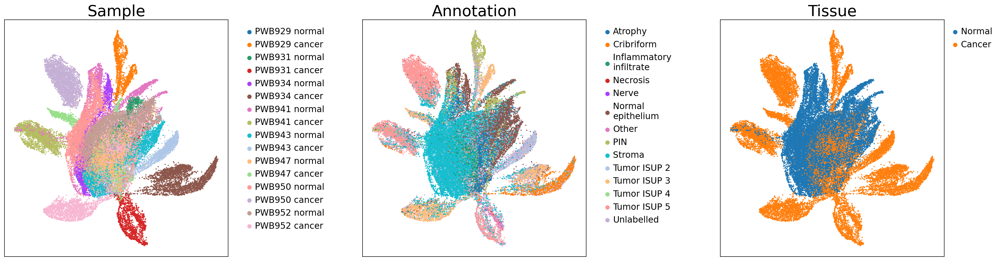

In [27]:
row_num = 1
col_num = 3
fig, axes = plt.subplots(row_num, col_num, figsize=[27, 7])
fig.subplots_adjust(wspace=0.6)
sc.pl.embedding(rna, f"X_umap", ax=axes[0], color="sample_name", show=False, title="Sample", size=15)
sc.pl.embedding(rna, f"X_umap", ax=axes[1], color="cell_type", show=False, title="Annotation", size=15)
sc.pl.embedding(rna,  f"X_umap",ax=axes[2], color="tissue_name", show=False, title="Tissue", size=15)
axes[0].legend(ncol=1, fontsize=14, bbox_to_anchor=(1.05, 1.0), frameon=False, alignment='center')
axes[1].legend(ncol=1, fontsize=14, bbox_to_anchor=(1.05, 1.0), frameon=False, alignment='center')
axes[2].legend(ncol=1, fontsize=14, bbox_to_anchor=(1.25, 1.0), frameon=False, alignment='center')
for j in range(col_num):
    axes[j].title.set_size(25)
    axes[j].set_ylabel("")
    axes[j].set_xlabel("")
            
plt.savefig("figures/rna.png", bbox_inches="tight", pad_inches=0.5)

In [28]:
msi = mdata.mod["msi"]
sc.pp.neighbors(msi, n_neighbors=30)
sc.tl.umap(msi)

         Falling back to preprocessing with `sc.pp.pca` and default params.


In [30]:
msi.obs["sample_name"] = mdata.obs["sample_name"].apply(lambda x: x.replace("\n", " "))
msi.obs["tissue_name"] = mdata.obs["tissue_name"].apply(lambda x: x.replace("\n", " "))
msi.obs["cell_type"] = mdata.obs["cell_type"]

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


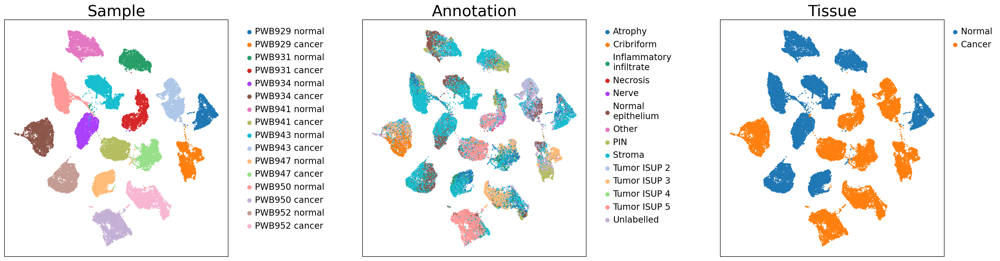

In [31]:
row_num = 1
col_num = 3
fig, axes = plt.subplots(row_num, col_num, figsize=[27, 7])
fig.subplots_adjust(wspace=0.6)
sc.pl.embedding(msi, f"X_umap", ax=axes[0], color="sample_name", show=False, title="Sample", size=15)
sc.pl.embedding(msi, f"X_umap", ax=axes[1], color="cell_type", show=False, title="Annotation", size=15)
sc.pl.embedding(msi,  f"X_umap",ax=axes[2], color="tissue_name", show=False, title="Tissue", size=15)
axes[0].legend(ncol=1, fontsize=14, bbox_to_anchor=(1.05, 1.0), frameon=False, alignment='center')
axes[1].legend(ncol=1, fontsize=14, bbox_to_anchor=(1.05, 1.0), frameon=False, alignment='center')
axes[2].legend(ncol=1, fontsize=14, bbox_to_anchor=(1.25, 1.0), frameon=False, alignment='center')
for j in range(col_num):
    axes[j].title.set_size(25)
    axes[j].set_ylabel("")
    axes[j].set_xlabel("")
            
plt.savefig("figures/msi.png", bbox_inches="tight", pad_inches=0.5)

## Logs

In [ ]:
from src.utils import get_loss_logs, make_plot
import string

In [66]:
## change with gamma
keys = {
    "smvae_beta0.001": "SMVAE(beta=0.001, gamma=0)",
    "smvae_beta0.001_gamma0.0001": "SMVAE(beta=0.001, gamma=0.0001)",
    "smvae_beta0.001_gamma0.0005": "SMVAE(beta=0.001, gamma=0.0005)",
}

datas = {}
for key in keys:
    datas[key] = get_loss_logs(models[key])

In [62]:
datas["smvae_beta0.001"].columns

Index(['step', 'PoE_training/total_loss', 'PoE_training/private',
       'PoE_training/shared', 'PoE_training/rna_mse', 'PoE_training/msi_mse',
       'PoE_training/recovered_rna_poe', 'PoE_training/recovered_msi_poe',
       'PoE_training/loss_msi_rna', 'PoE_training/loss_rna_msi',
       'PoE_training/kl', 'PoE_training/kl_rna_p', 'PoE_training/kl_msi_p',
       'PoE_training/kl_rna_s', 'PoE_training/kl_msi_s', 'PoE_test/Test loss',
       'PoE_test/batch_integration_loss'],
      dtype='object')

In [67]:
c = ["PoE_training/total_loss", "PoE_training/kl", "PoE_training/kl_rna_p", "PoE_training/kl_msi_p", 
     "PoE_training/kl_rna_s", "PoE_training/kl_msi_s", "PoE_training/batch_integration"]

rds = []
for key, logs in datas.items():
    logs["model"] = keys[key]
    if "gamma" not in key:
        rds.append(logs.loc[:, ["step", "model", *c[:-1]]])
    else:
        rds.append(logs.loc[:, ["step", "model", *c]])

data = pd.concat(rds, ignore_index=True)
data["model"] = data["model"].astype("category")

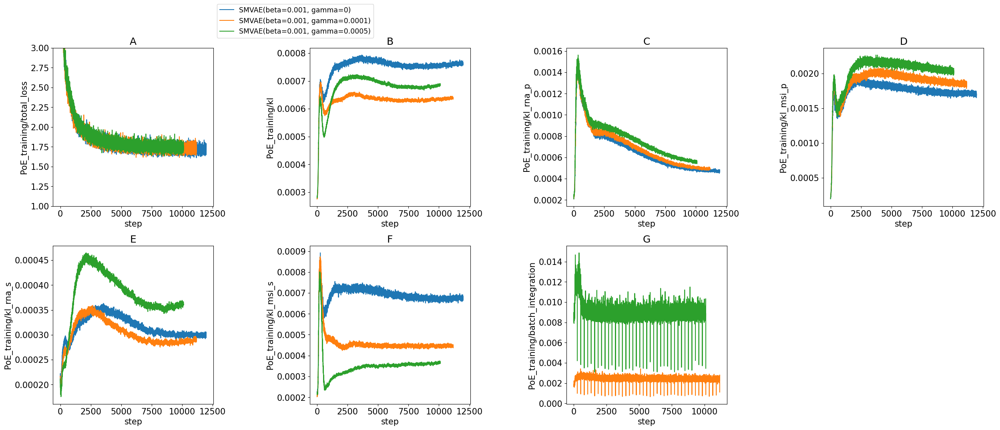

In [92]:
row_n, col_n = (2, 4)
fig, axes = plt.subplots(row_n, col_n, figsize=(30, 9))
fig.subplots_adjust(wspace=0.6, hspace=0.25, top=1.1)
fig.delaxes(axes[1,3])

for i, col in enumerate(c):
    if i == 0:
        sns.lineplot(ax=axes[0][0], data=data, x="step", y=c[i], hue="model")
        axes[0][0].legend(ncol=1, fontsize="small", bbox_to_anchor=(1, 1.3))
        axes[0][0].set(ylim=(1, 3))
    else:
        sns.lineplot(ax=axes[int(i / col_n)][i % col_n], data=data, x="step", y=c[i], hue="model", legend=False)
    axes[int(i / col_n)][i % col_n].title.set_text(string.ascii_uppercase[i])

In [93]:
### delta
keys = {
    "smvae_beta0.001_gamma0.0005_delta1.0": "SMVAE(beta=0.001, gamma=0,0005, delta=1.0)",
    "smvae_beta0.001_gamma0.0005_delta0.1": "SMVAE(beta=0.001, gamma=0.0005, delta=0.1)",
    "smvae_beta0.001_gamma0.0005": "SMVAE(beta=0.001, gamma=0.0005, delta=0.0)",
}

datas = {}
for key in keys:
    datas[key] = get_loss_logs(models[key])

In [94]:
c = ["PoE_training/total_loss", "PoE_training/kl", "PoE_training/kl_rna_p", "PoE_training/kl_rna_s", 
                                "PoE_training/kl_msi_p", "PoE_training/kl_msi_s", 
     "PoE_training/batch_integration_msi", "PoE_training/batch_integration_rna", "PoE_training/batch_integration", 
     "PoE_training/batch_loss"]

rds = []
for key, logs in datas.items():
    logs["model"] = keys[key]
    if "delta" not in key:
        rds.append(logs.loc[:, ["step", "model", *c[:-4], *c[-2:]]])
    else:
        rds.append(logs.loc[:, ["step", "model", *c]])

data = pd.concat(rds, ignore_index=True)
data["model"] = data["model"].astype("category")
data["PoE_training/batch_integration"] = data["PoE_training/batch_loss"] * 0.0005

In [ ]:
n_row = 3
n_col = 3
fig, axes = plt.subplots(n_row, n_col, figsize=(30, 15))
fig.subplots_adjust(wspace=0.6, hspace=0.25, top=1.1)

for i, col in enumerate(c[:-1]):
    if i == 0:
        sns.lineplot(ax=axes[int(i / n_col)][i % n_col], data=data, x="step", y=col, hue="model")
        axes[0][0].legend(ncol=1, fontsize="small", bbox_to_anchor=(1, 1.3))
        axes[0][0].set(ylim=(1.0, 5.0))
    else:
        sns.lineplot(ax=axes[int(i / n_col)][i % n_col], data=data, x="step", y=col, hue="model", legend=False)
        
    if col == "PoE_training/batch_integration_msi":
        axes[int(i / n_col)][i % n_col].set(ylabel="PoE_training/batch_separation_msi")
    if col == "PoE_training/batch_integration_rna":
        axes[int(i / n_col)][i % n_col].set(ylabel="PoE_training/batch_separation_rna")
        
    axes[int(i / n_col)][i % n_col].title.set_text(string.ascii_uppercase[i])

## Classification

In [97]:
from src.smvae.diagnostics import classification_performance
from tqdm import tqdm

perf_df = pd.read_csv("classification/smvae")
# perf_df = pd.DataFrame(index=mdata.obs["sample"].unique(), columns=models.keys())

# for m in models.keys():
#     for sample in tqdm(mdata.obs["sample"].unique()):
#         perf_df.loc[sample, m] = classification_performance(mdata, label_key="new_ann", embed_key=f"X_{m}_z", loo=sample)[0]
#     perf_df.to_csv("classification/smvae")

In [98]:
perf_df.mean()

/tmp/ipykernel_541433/3976431540.py:1: FutureWarning: The default value of numeric_only in DataFrame.mean is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.
  perf_df.mean()


smvae_beta0.01                          0.304935
smvae_beta0.001                         0.310817
smvae_beta0.001_gamma0.0001             0.330750
smvae_beta0.001_gamma0.0003             0.372189
smvae_beta0.001_gamma0.0005             0.360455
smvae_beta0.001_gamma0.001              0.306326
smvae_beta0.001_gamma0.01               0.319260
smvae_beta0.001_gamma0.0001_delta0.1    0.345189
smvae_beta0.001_gamma0.0005_delta0.1    0.338460
smvae_beta0.1                           0.328104
smvae_beta0.1_gamma0.0001               0.324437
smvae_beta0.001_gamma0.0005_delta1.0    0.338893
dtype: float64

## kBET

In [64]:
from src.loss import calc_kBET
# kbet = {}
# for m in models.keys():
#     kbet[m] = calc_kBET(mdata, "sample", m)

In [71]:
# a = pd.DataFrame(kbet, index=["stat_mean", "pvalue_mean", "accept_rate"]).T
# a.to_csv("classification/kbet_smvae")
a = pd.read_csv("classification/kbet_smvae", index_col="Unnamed: 0")

In [73]:
a = a.drop("smvae_beta0.1_gamma0.0001")

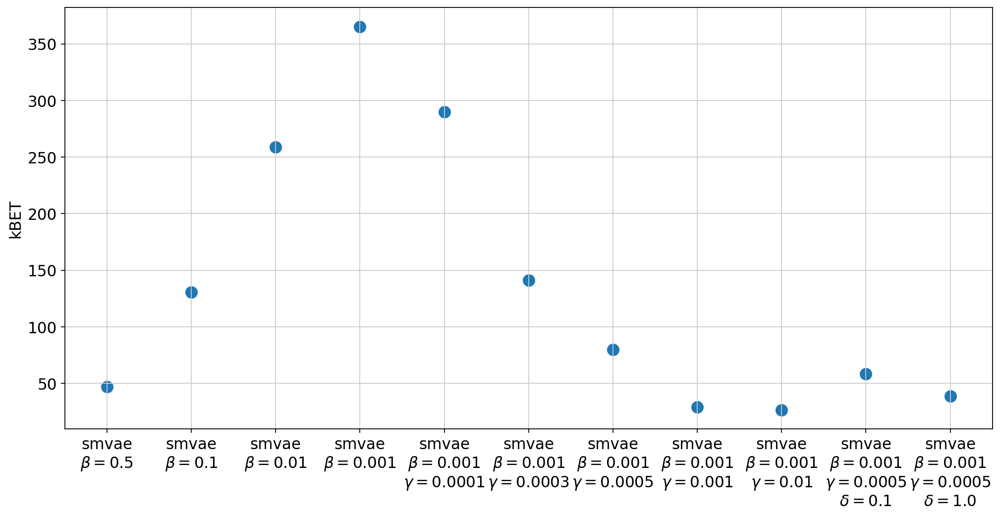

In [83]:
labels = [
    label.replace("_", "\n")
    .replace("beta", r"$\beta=$")
    .replace("gamma", r"$\gamma=$")
    .replace("delta", r"$\delta=$")
    for label in a.iloc[:,0].keys()
]

fig = plt.figure(figsize=(15, 7))
ax = fig.add_subplot(1, 1, 1)
sns.scatterplot(a["stat_mean"], ax=ax, s=150)
ax.set_xticks(ticks=range(len(labels)), labels=labels, fontsize=14)
ax.set_ylabel("kBET")
plt.savefig("figures/smvae_kbet.png", bbox_inches="tight", pad_inches=0.5)